# CNN dataset validation
Using all our currently obtained images, the CNN is made to find (if exists) artifacts and draw the spline.

NVIDIA GeForce RTX 3090
Prediction: 0.3989982604980469 seconds
Prediction: 0.26399898529052734 seconds
Prediction: 0.26800036430358887 seconds
Prediction: 0.2700026035308838 seconds
Prediction: 0.26599740982055664 seconds
Prediction: 0.2740004062652588 seconds
Prediction: 0.2709989547729492 seconds
Prediction: 0.26300048828125 seconds
Prediction: 0.26399827003479004 seconds
Prediction: 0.2709982395172119 seconds
Prediction: 0.265000581741333 seconds
Prediction: 0.2759995460510254 seconds
Prediction: 0.27500081062316895 seconds
Prediction: 0.2590017318725586 seconds
Prediction: 0.2589995861053467 seconds
Prediction: 0.2590022087097168 seconds
Prediction: 0.26200270652770996 seconds
Prediction: 0.2649984359741211 seconds
Prediction: 0.27899742126464844 seconds
Prediction: 0.2739987373352051 seconds
Prediction: 0.2610015869140625 seconds


C:\Users\C\AppData\Local\Temp\ipykernel_8716\3000129539.py:60: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(18, 6))


Prediction: 0.2669992446899414 seconds
Prediction: 0.2689993381500244 seconds
Prediction: 0.26399993896484375 seconds
Prediction: 0.26038670539855957 seconds
Prediction: 0.26799845695495605 seconds
Prediction: 0.2649993896484375 seconds
Prediction: 0.26000142097473145 seconds
Prediction: 0.2570013999938965 seconds
Prediction: 0.261000394821167 seconds
Prediction: 0.26400017738342285 seconds
Prediction: 0.27544283866882324 seconds
Prediction: 0.2630007266998291 seconds
Prediction: 0.26400089263916016 seconds
Prediction: 0.2629997730255127 seconds
Prediction: 0.2620224952697754 seconds
Prediction: 0.26444029808044434 seconds
Prediction: 0.2630019187927246 seconds
Prediction: 0.27138805389404297 seconds
Prediction: 0.2777070999145508 seconds
Prediction: 0.27489304542541504 seconds
Prediction: 0.2653627395629883 seconds
Prediction: 0.26199865341186523 seconds
Prediction: 0.26399993896484375 seconds
Prediction: 0.2650015354156494 seconds
Prediction: 0.26334667205810547 seconds
Prediction: 0

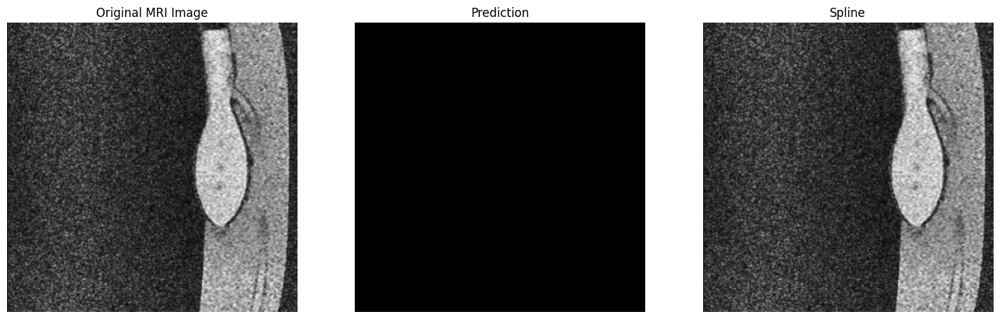

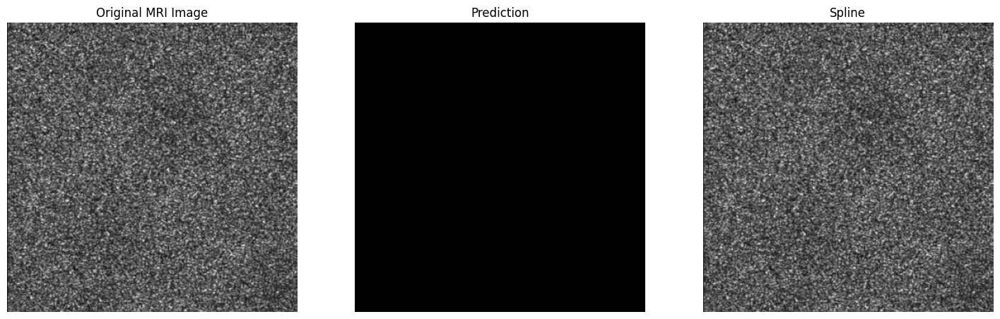

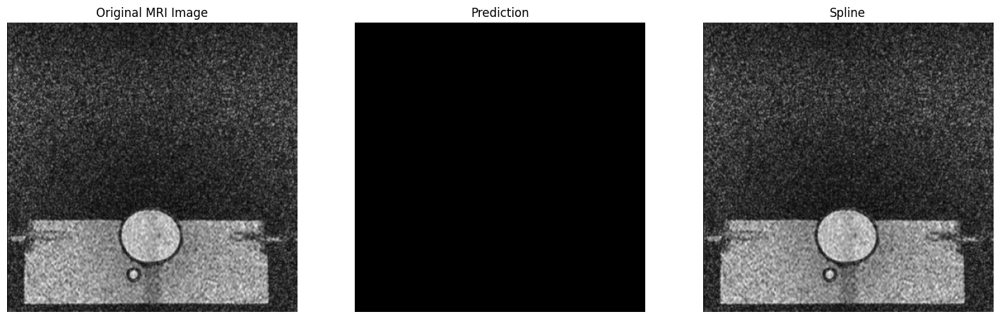

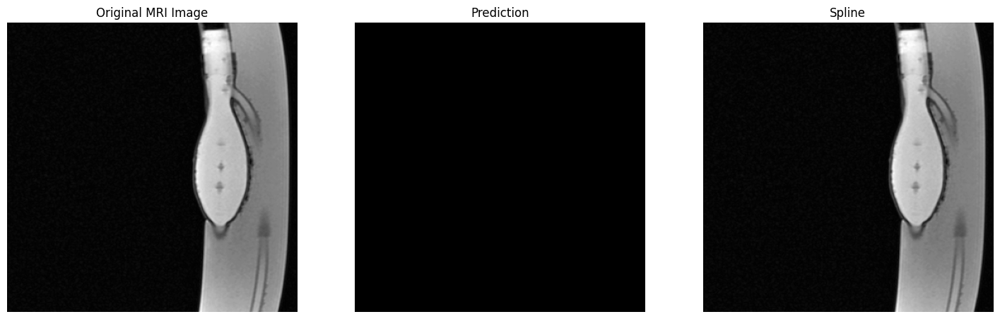

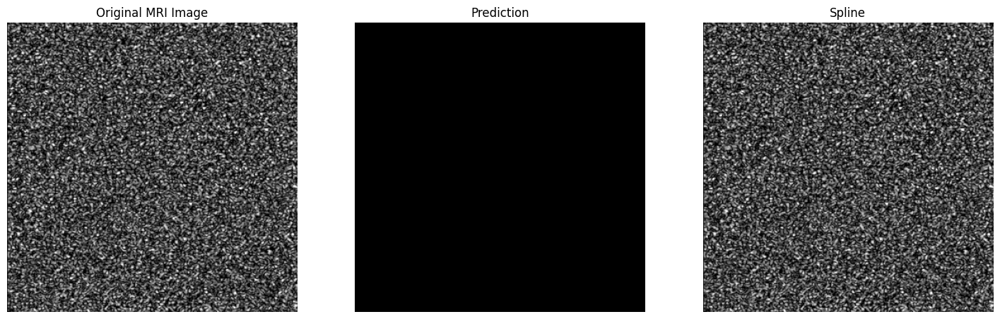

...

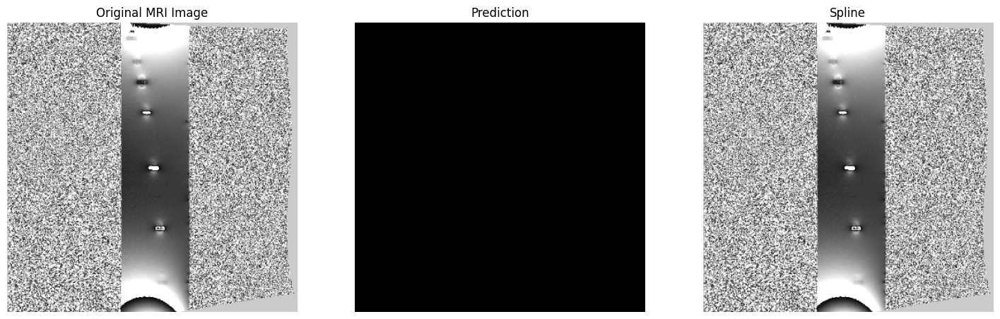

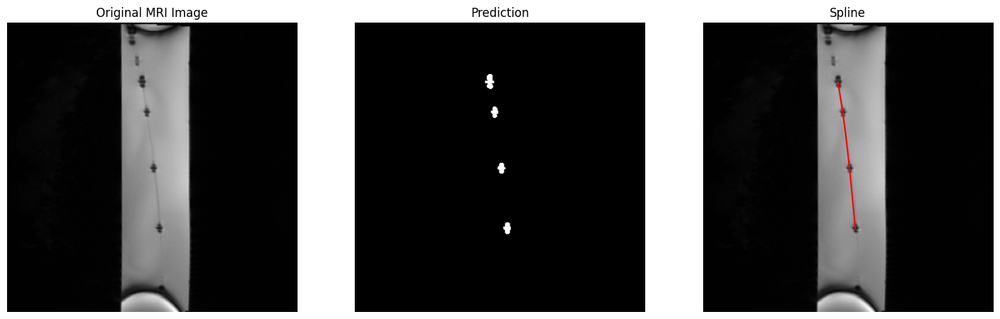

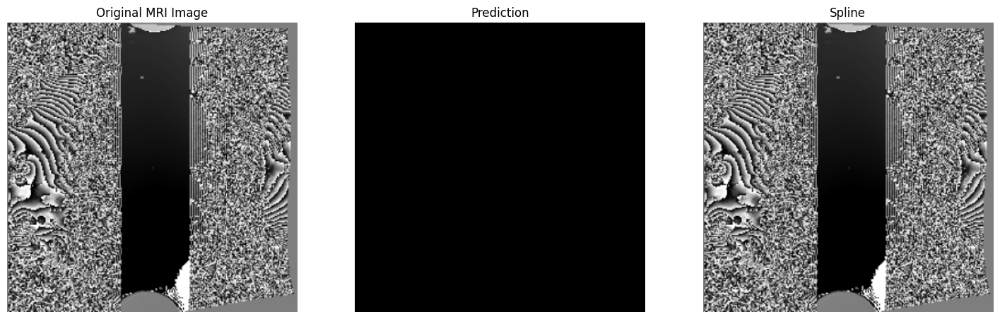

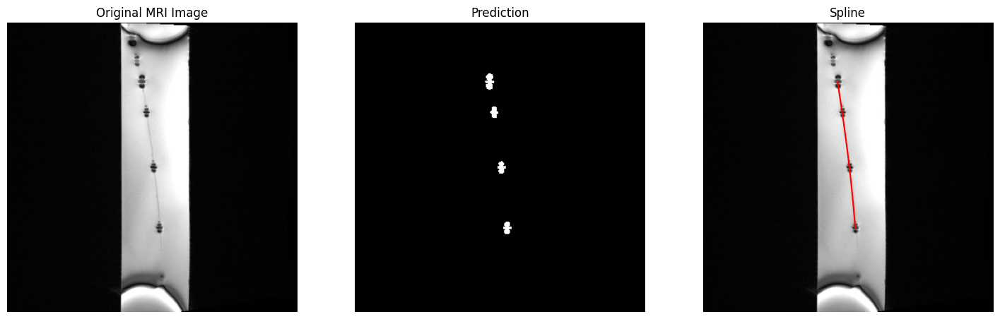

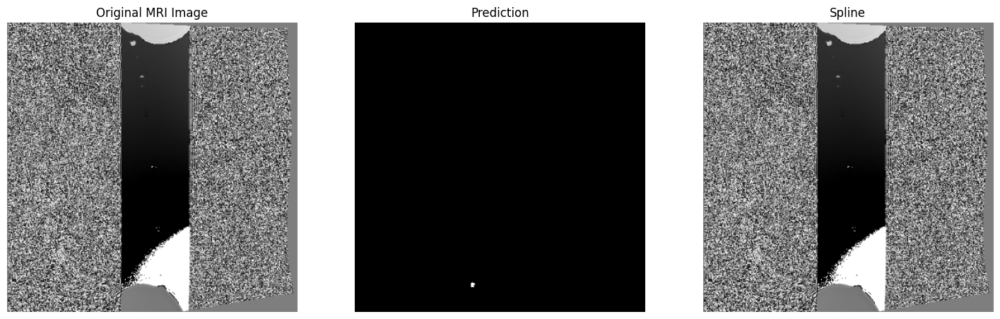

In [3]:
"""
https://github.com/MIC-DKFZ/nnUNet/blob/master/nnunetv2/inference/examples.py
"""
%matplotlib inline
from skimage import measure
import torch
from nnunetv2.inference.predict_from_raw_data import nnUNetPredictor
import cv2
import time
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import splprep, splev

if __name__ == '__main__':
    # instantiate the nnUNetPredictor
    predictor = nnUNetPredictor(
        tile_step_size=1,
        use_gaussian=True,
        use_mirroring=True,
        perform_everything_on_gpu=True,
        device=torch.device('cuda', 0),
        verbose=False,
        verbose_preprocessing=False,
        allow_tqdm=False
    )
    
    print(torch.cuda.get_device_name(0))
    
    predictor.initialize_from_trained_model_folder("MODEL_350", checkpoint_name='checkpoint_final.pth', use_folds=(4,))
    # while True:
    IMAGE_SIZE = (350, 350)
    for test_image in os.listdir("MRI_LABS"):
        image = cv2.imread(os.path.join("MRI_LABS", test_image), cv2.IMREAD_GRAYSCALE)
        image = cv2.resize(image, IMAGE_SIZE).astype(np.float32) / 255.0
        cnn_input = image.reshape(1, 1, image.shape[0], image.shape[1])
        props = {'spacing': (999, 1, 1)}
        
        start_time = time.time()
        output = predictor.predict_single_npy_array(cnn_input, props, None, None, True)[0]
        print("Prediction: %s seconds" % (time.time() - start_time))
        
        output_display = (output * 255).astype(np.uint8).reshape(IMAGE_SIZE)
        image_display = (image * 255).astype(np.uint8)
        
        labels = measure.label(output_display > 128)  # Threshold adjusted as needed
        properties = measure.regionprops(labels)
        centers = np.array([prop.centroid for prop in properties])
        
        spline_points = []
        
        if len(centers) > 1:
            try:
                tck, _ = splprep(centers.T, s=0)
                spline_points = splev(np.linspace(0, 1, 1000), tck)
            except:
                pass
        
        # Using Matplotlib to display the images
        plt.figure(figsize=(18, 6))
        plt.subplot(1, 3, 1)
        plt.imshow(image_display, cmap='gray')
        plt.title("Original MRI Image")
        plt.axis('off')
        
        plt.subplot(1, 3, 2)
        plt.imshow(output_display, cmap='gray')
        plt.title("Prediction")
        plt.axis('off')
        
        plt.subplot(1, 3, 3)
        plt.imshow(image_display, cmap='gray')
        if len(spline_points) > 0:
            plt.plot(spline_points[1], spline_points[0], 'r-')
        plt.title("Spline")
        plt.axis('off')
    plt.show()
    